# [E-10] 인공지능으로 세상에 없던 새로운 패션 만들기

지금까지 배웠던 딥러닝 모델은 입력받은 데이터를 어떤 기준에 대해 판별하는 것이 목표인 **판별 모델링(Discriminative Modeling)**이라고 부른다.
<br>
하지만 이번 노드에서 배울 **생성 모델링(Generative Modeling)**은 말 그대로 없던 데이터를 생성해 내는 것이 목표이다. 가위바위보 프로젝트를 예로 든다면 다양한 가위, 바위, 보가 담긴 데이터셋에서 각 이미지의 특징을 학습해 그와 비슷한 새로운 사진을 만들어내야 하는 것이다. 기왕 만드는 김에 실제 사진과 거의 구별이 어려울 정도로 좋은 퀄리티의 이미지를 만들어내는 것이 최종 목표이다.

## 1. 이론

### 여러가지 생성 모델링 기법과 친해지기 (1) Pix2Pix

> **Pix2Pix는 간단한 이미지를 입력할 경우 실제 사진처럼 보이도록 바꿔줄 때 많이 사용되는 모델이다.**

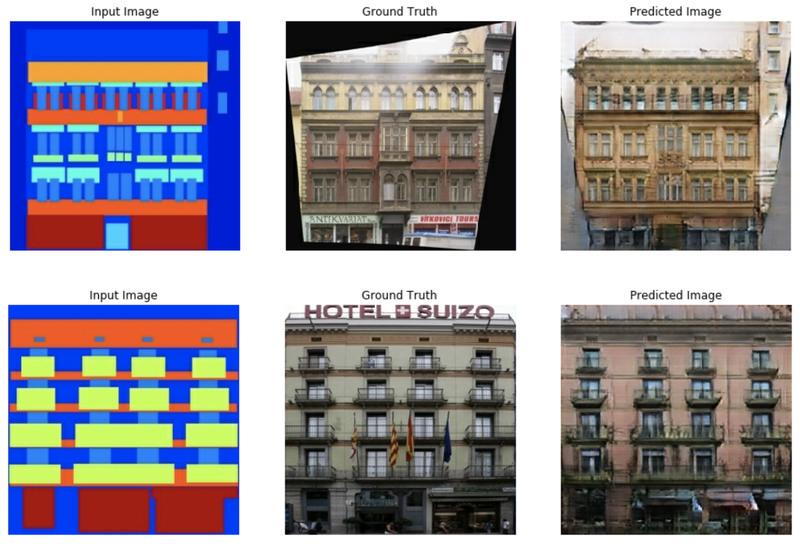

* 이미지를 다른 이미지로 픽셀 단위로 변환한다는 뜻의 Pixel to Pixel을 딴 Pix2Pix라는 이름이 붙게 됨.
<br>
* 모델은 단순화된 이미지(Input Image)와 실제 이미지(Ground Truth)가 쌍을 이루는 데이터셋으로 학습을 진행한다.
* 왼쪽의 Input Image를 입력받으면, 내부 연산을 통해 실제 사진 같은 형상으로 변환된 Predicted Image를 출력한다.
* 학습 초기에는 모델이 생성한 predicted Image와 Ground Truth 이미지가 많이 다르겠지만, **계속해서 Ground Truth와 얼마나 비슷한지를 평가해 점차 실제같은 결과물을 만들어내게 된다.**

### 여러 가지 생성 모델링 기법과 친해지기 (2) CycleGAN
> **모네의 그림을 사진으로, 사진을 다시 모네의 그림으로: CycleGAN**

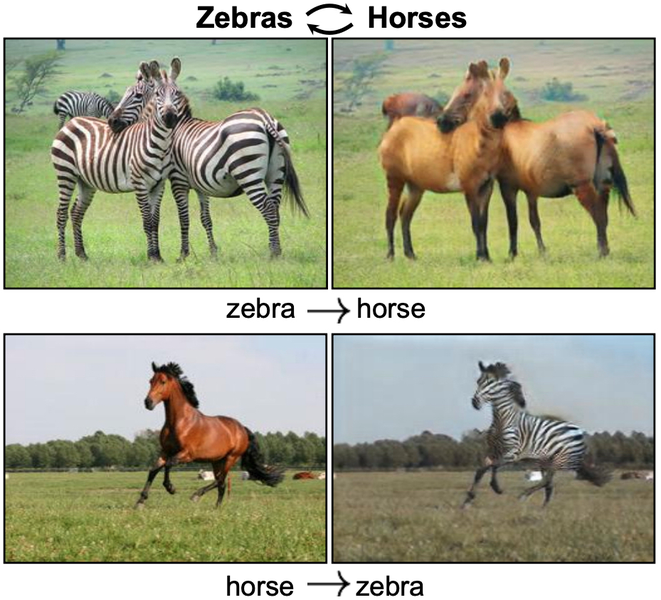

* Pix2Pix 이후 발전된 모델로서, 한 이미지와 다른 이미지를 번갈아 가며 Cyclic하게 변환시킬 수 있다. 
* 단 방향으로의 변환만 가능한 Pix2Pix에서 발전한 형태인 CycleGAN은 양방향으로의 이미지 변환이 가능하다. 
* 그림과 사진의 쌍으로 이루어진 데이터셋이 필요했던 Pix2Pix와 달리, CycleGAN은 쌍이 필요없다. 
    * 위 이미지들과 같이 얼룩말을 그냥 말로, 말을 얼룩말로 서로 변환할 경우 쌍을 이루지 않더라도 그냥 얼룩말이 있는 사진과 말이 있는 사진, 즉 **쌍을 이루지 않더라도 각각의 데이터셋만 있으면 CycleGAN을 학습시킬 수 있다.**
    * 모델이 스스로 얼룩말과 말 데이터에서 각각의 스타일을 학습해서 새로운 이미지에 그 스타일을 입힐 수 있도록 설계되었기 때문이다.
    * 쌍으로 된 데이터(paired data)가 필요 없기 때문에 데이터를 구하기 훨씬 쉽고, 라벨을 붙이는 주석 비용이 필요 없다.

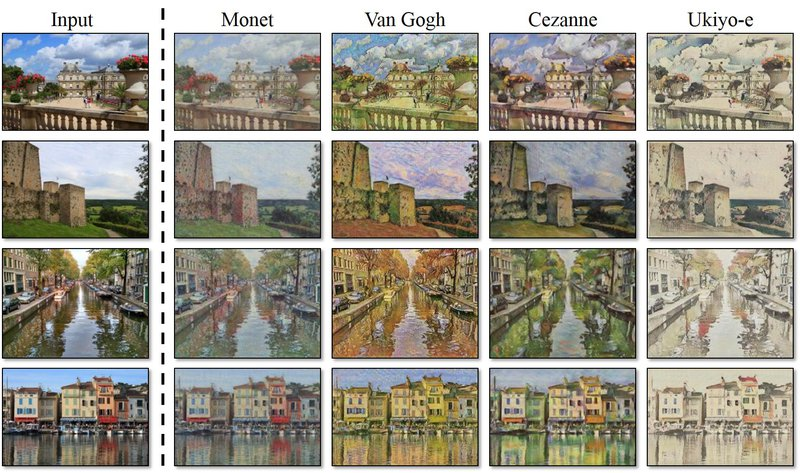

### 여러가지 생성 모델링 기법과 친해지기 (3) Neural Style Transfer
> **사진에 내가 원하는 스타일을 입혀보자: Neural Style Transfer**

Neural Style Transfer기법은 이미지의 스타일을 변환시킨다.
* Neural, 즉 딥러닝 기술을 사용했다는 뜻을 가지고 있음.
* 전체 이미지의 구성을 유지하고 싶은 Base Image와 입히고 싶은 스타일이 담긴 Style Image 두 장을 활용해 새로운 이미지를 만들어 낸다.


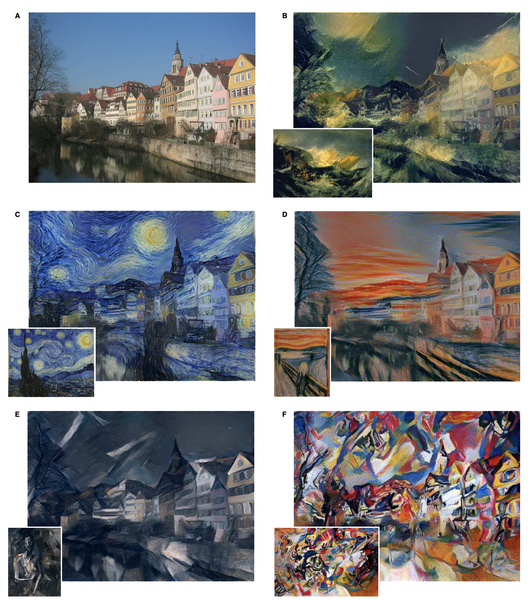

* Base Image에서 content만, Style Image에서는 Style만 추출해서 합친다.
* 이런 결과를 만들어내는 과정 속에는 다양한 최적화가 포함되어 있다. 
    * Base Image의 내용은 잃지 않으면서, Style Image의 스타일을 효과적으로 입히기 위한 정교한 손실함수들이 짜여 있다.

***

## 2. 실습

### 2-1. 데이터 준비

이번 노드에서는 Fashion MNIST 데이터셋을 사용한다.

In [2]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
import matplotlib.pyplot as plt
%matplotlib inline

print("tensorflow", tf.__version__)

tensorflow 2.6.0


In [3]:
# keras 안에 있는 datasets에서 fashion_mnist를 받아온다
# 분류 문제와 달리 어떤 카테고리인지 나타내는 라벨은 필요없다.
# 즉, y_train, y_test에 해당하는 데이터는 쓰지 않는다.
fashion_mnist = tf.keras.datasets.fashion_mnist

(train_x, _), (test_x, _) = fashion_mnist.load_data()

4431872/4422102 [==============================] - 0s 0us/step


In [5]:
# 픽셀값 확인

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 255
min pixel: 0


In [6]:
# 추후 각 픽셀을 -1, 1로 정규화 시켜서 사용할 예정임
# 따라서 중간값을 0으로 맞춰주기 위해 127.5를 뺀 후 127.5로 나누어준다.

train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화합니다.

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


In [7]:
train_x.shape

(60000, 28, 28)

fashion_mnist 데이터셋은 train 데이터 7만장, test 데이터 1만장으로 구성되어 있고 이미지의 사이즈는 28x28이다.
<br>
다만 딥러닝에서 이미지를 다루려면 **채널 수**에 대한 차원이 필요하다. 입력되는 이미지 데이터의 채널 수는 어떤 이미지냐에 따라 달라지는데, 컬러 이미지의 경우 RGB 세개 채널이 있고, 흑백의 경우 1개의 채널만 존재한다. Fashion MNIST 데이터는 흑백이미지이므로, 채널 값은 1이다. 이 채널값을 데이터셋의 shape 마지막에 추가해준다.

In [8]:
train_x = train_x.reshape(train_x.shape[0], 28, 28, 1).astype('float32')
train_x.shape

(60000, 28, 28, 1)

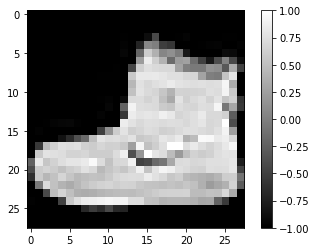

In [9]:
# 첫번째 데이터를 꺼내서 어떻게 생겼는지 확인해보자
plt.imshow(train_x[0].reshape(28, 28), cmap='gray')
plt.colorbar()
plt.show()

* 첫 번재 이미지, index[0]의 이미지는 신발이다.
* plt.colorbar()를 이용해 오른쪽에 각 픽셀의 값과 그에 따른 색도 확인했는데, 1~-1까지 정규화 해준 값을 가지고, -1이 가장 어두운 색, 1이 가장 밝은 흰색을 띈다고 표시되어 있다.

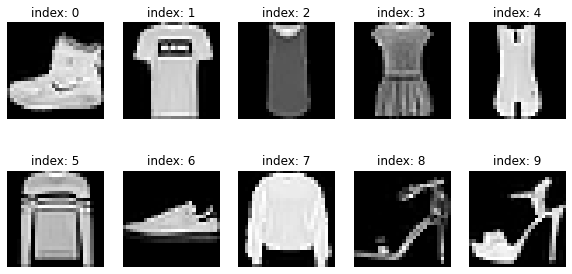

In [12]:
# 열개 보기
plt.figure(figsize=(10, 5))

for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.imshow(train_x[i].reshape(28, 28), cmap='gray')
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

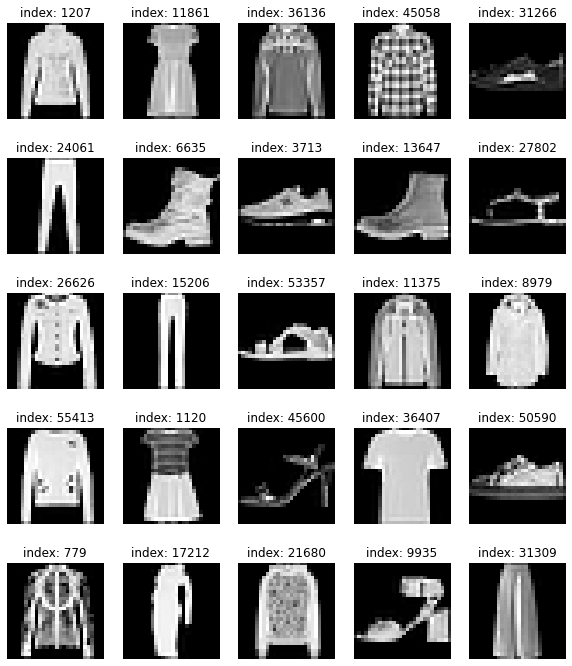

In [13]:
plt.figure(figsize=(10, 12))

for i in range(25):
    plt.subplot(5, 5, i+1)
    random_index = np.random.randint(1, 60000)
    plt.imshow(train_x[random_index].reshape(28, 28), cmap='gray')
    plt.title(f'index: {random_index}')
    plt.axis('off')
plt.show()

여기까지해서 데이터에 대한 전처리는 끝남. 이렇게 정리된 데이터를 모델에 넣어서 학습해야하니까, 편하게 사용할 수 있도록 tensorflow의 Dataset을 이용해 준비해 놓도록 한다. 이러면 매번 모델에게 직접 섞어서 넣어주지 않아도 됨.

In [14]:
BUFFER_SIZE = 60000    # 전체 데이터를 섞기 위해 60000으로 설정
BATCH_SIZE = 256    # 모델이 한 번에 학습할 데이터의 양

In [16]:
# tf.data.Dataset 모듈의 from_tensor_slices() 함수를 사용하면
# 리스트, 넘파이, 또는 텐서플로우의 텐서 자료형에서 데이터셋을 만들 수 있다.
# train_x라는 넘파이 배열형 자료를 섞고, 이를 배치 사이즈에 따라 나눈다.
# 단, 데이터가 잘 섞이게 하려면 버퍼 사이즈를 총 데이터 사이즈와 같거나 크게 설정하는 것이 좋다.
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

### 2-2. GAN(Generative Adversarial Network) 이해하기

생성 모델 중 하나인 GAN에는 **두 가지 네트워크가 있다.**
* 생성자(Generator)
    * 아무 의미 없는 랜덤 노이즈로부터 신경망에서의 연산을 통해 이미지 형상의 벡터를 생성해낸다.
    * 즉, 무에서 유를 창조하는 것과 같은 역할을 한다.
<br>
<br>
* 판별자(Discriminator)
    * 기존에 있던 진짜 이미지와 생성자가 만들어낸 이미지를 입력받아 각 이미지가 Real인지 Fake인지에 대한 판단 정도를 실숫값으로 출력한다.
<br>
<br>
생성자와 판별자는 서로 경쟁하며 성장한다.

### 2-3. 생성자 구현하기

이번 노드에서 구현해볼 모델은 DCGAN(Deep Convolutional GAN)이다. 모델의 구현은 keras sequential API를 활용한다. 
<br>
https://www.tensorflow.org/tutorials/generative/dcgan?hl=ko 참고

In [17]:
# 언제든 생성자를 만들 수 있도록 make_generator_model 함수를 만든다.

def make_generator_model():
# tf.keras.Sequential()로 모델을 시작한 후 레이어를 차곡차곡 쌓아준다.

    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Second: Reshape layer
    model.add(layers.Reshape((7, 7, 256)))

    # Third: Conv2DTranspose layer
    # 가장 중요한 레이어이다.
    # 일반적인 conv2D와 반대로 이미지 사이즈를 넓혀주는 층이다.
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(1, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, \
                                     activation='tanh'))

    return model

이 모델에서는 세 번의 Conv2DTranspose층을 이용해 (7, 7, 256)->(14, 14, 64)->(28, 28, 1)순으로 이미지를 키워나간다. 여기서 최종 사이즈인 (28, 28, 1)은 우리가 준비했던 데이터셋과 형상이 동일하다.

In [18]:
generator = make_generator_model()

generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 12544)             1254400   
_________________________________________________________________
batch_normalization (BatchNo (None, 12544)             50176     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 12544)             0         
_________________________________________________________________
reshape (Reshape)            (None, 7, 7, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 7, 7, 128)         819200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 7, 7, 128)         512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 7, 7, 128)         0

In [19]:
noise = tf.random.normal([1, 100])

In [20]:
generated_image = generator(noise, training=False)
generated_image.shape

TensorShape([1, 28, 28, 1])

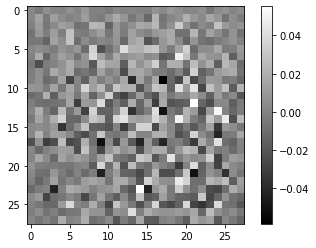

In [21]:
plt.imshow(generated_image[0, :, :, 0], cmap='gray')
plt.colorbar()
plt.show()

### 2-4 판별자 구현하기

In [22]:
def make_discriminator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[28, 28, 1]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Third: Flatten Layer
    model.add(layers.Flatten())

    # Fourth: Dense Layer
    model.add(layers.Dense(1))

    return model

In [23]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 14, 14, 64)        1664      
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 14, 14, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 7, 7, 128)         204928    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 7, 7, 128)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 7, 7, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 6272)             

In [24]:
decision = discriminator(generated_image, training=False)
decision

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[-0.00453609]], dtype=float32)>

### 2-5. 손실함수와 최적화 함수

딥러닝 모델이 학습하기 위해서 꼭 필요한 두 가지는, 바로 손실함수(loss function)과 최적화 함수(optimizer)이다.

* 손실함수
    * GAN은 손실함수로 교차 엔트로피(cross-entropy)를 사용한다.
    * 교차 엔트로피는 점점 가까워지기 원하는 두 값이 얼마나 큰 차이가 나는지를 정량적으로 계산할 때 많이 쓰인다.
    * 특히 판별자는 한 개의 이미지가 가짜인지 진짜인지 나타내는 2개 클래스 간 분류 문제를 풀어야 하므로, 이진 교차 엔트로피(binary cross entropy)를 사용할 것.
<br>
<br>
Real Image에 대한 라벨을 1, Fake Image는 0으로 두었을 때, 각각의 손실함수를 이용해 정량적으로 달성해야하는 목표 결과는 다음과 같다.
* 생성자: 판별자가 Fake Image에 대해 판별한 값, 즉 D(fake_image)값이 1에 가까워지는 것.
* 판별자: Real Image 판별값, 즉 D(real_image)는 1에, Fake Image 판별값, 즉 D(fake_image)는 0에 가까워지는 것.
<br>
<br>
정리하면 결국 생성자든 구분자든 손실함수에 들어가는 값은 모두 판별자의 판별값이 된다.

손실함수를 설계하기 전에 주의해야할 점은 우리가 교차 엔트로피를 계산하기 위해 입력할 값은 판별자가 판별한 값인데, 판별자 모델의 맨 마지막 Layer에는 값을 정규화시키는 sigmoid나 tanh 함수와 같은 활성화 함수가 없었음. 즉, **구분자가 출력하는 값은 범위가 정해지지 않아 모든 실숫값을 가질 수 있다.**

In [25]:
# 손실함수에 사용할 교차 엔트로피 함수는 tf.keras.losses 라이브러리 안에 있다.
# tf.keras.losses의 BinaryCrossEntropy 클래스는 기본적으로 본인에게 들어오는 인풋값이 0-1 사이에 분포하는 확률값이라고 가정한다.
# 따라서 from_logits를 True로 설정해 주어야 BinaryCrossEntropy에 입력된 값을 함수 내부에서 sigmoid함수를 사용해 0-1 사이 값으로 졍규화한 후 알맞게 계산할 수 있다.
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

cross_entropy를 활용해 계산할 loss들은 fake_output과 real_output 두가지를 활용한다.
* fake_output: 생성자가 생성한 Fake Image를 구분자에 입력시켜서 판별된 값, 즉 D(fake_image)
* real_output: 기존에 있는 Real Image를 구분자에 입력시켜서 판별된 값, 즉 D(real_image)

그럼 fake_output과 real_output을 각각 1 또는 0에 비교를 해야하는데 이때 **tf.ones_like()와 tf.zeros_like() 함수를 사용한다.**
<br>
이 함수들은 특정 벡터와 동일한 크기이면서 값은 1 또는 0으로 가득 채워진 벡터를 만들고 싶을 때 사용한다.

In [26]:
# 실험
vector = [[1, 2, 3],
          [4, 5, 6]]

tf.ones_like(vector)

<tf.Tensor: shape=(2, 3), dtype=int32, numpy=
array([[1, 1, 1],
       [1, 1, 1]], dtype=int32)>

In [27]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [28]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [29]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

In [30]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [31]:
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

### 2-6. 훈련과정 설계

In [32]:
import numpy as np
import tensorflow as tf

def f(x, y):
  print(type(x))
  print(type(y))
  return x ** 2 + y

x = np.array([2, 3])
y = np.array([3, -2])
f(x, y)

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


array([7, 7])

In [33]:
import numpy as np
import tensorflow as tf

@tf.function    # 위와 동일한 함수이지만 @tf.function 데코레이터가 적용되었습니다.
def f(x, y):
  print(type(x))
  print(type(y))
  return x ** 2 + y

x = np.array([2, 3])
y = np.array([3, -2])
f(x, y)

<class 'tensorflow.python.framework.ops.Tensor'>
<class 'tensorflow.python.framework.ops.Tensor'>


<tf.Tensor: shape=(2,), dtype=int64, numpy=array([7, 7])>

In [34]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

In [35]:
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(predictions[i, :, :, 0], cmap='gray')
        plt.axis('off')
   
    plt.savefig('{}/aiffel/dcgan_newimage/fashion/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()

In [36]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/fashion/training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [37]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/fashion/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

### 2-7. 학습 시키기

In [38]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [42]:
save_every = 5
EPOCHS = 600

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

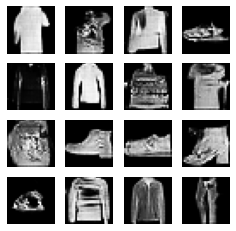

Time for training : 11127 sec


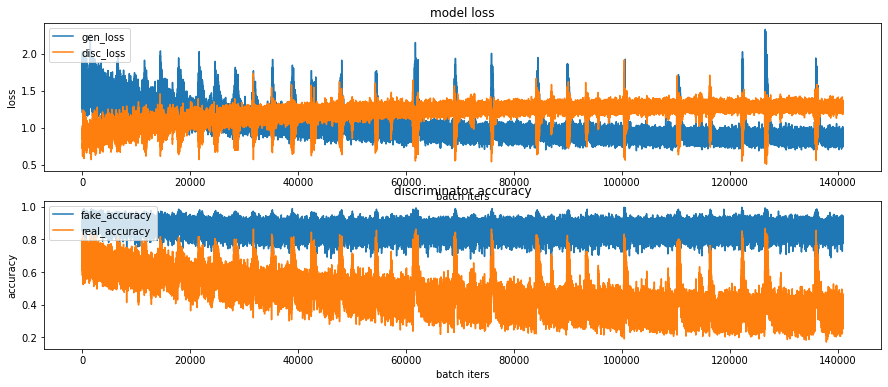

CPU times: user 1h 46min, sys: 16min 27s, total: 2h 2min 27s
Wall time: 3h 5min 35s


In [43]:
%%time
train(train_dataset, EPOCHS, save_every)

# 학습과정의 loss, accuracy 그래프 이미지 파일이 ~/aiffel/dcgan_newimage/fashion/training_history 경로에 생성되고 있으니
# 진행 과정을 수시로 확인해 보시길 권합니다.

In [5]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/fashion/fashion_mnist_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/fashion/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/fashion/fashion_mnist_dcgan.gif

-rw-r--r-- 1 root root 3235940 Feb 13 01:58 /aiffel/aiffel/dcgan_newimage/fashion/fashion_mnist_dcgan.gif


***

## 3. 프로젝트: CIFAR-10 이미지 생성하기

* 루브릭
    * 오브젝트 종류를 육안으로 구별할 수 있을 만한 이미지를 생성하였다.
    * gif를 통해 생성이미지 품질이 서서히 향상되는 것과, fake accuracy가 추세적으로 0.5를 향해 하향하고 있음을 확인하였다.
    * 제출 아이디어를 제출 프로젝트에 반영하고, 그 결과가 아이디어 적용 이전보다 향상되었음을 시각적으로 입증하였다.

In [35]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
from tensorflow.keras.utils import plot_model
import matplotlib.pyplot as plt
%matplotlib inline

print("tensorflow", tf.__version__)

tensorflow 2.6.0


In [36]:
import random as python_random

def fix_seed():
    np.random.seed(123)
    python_random.seed(123)
    tf.random.set_seed(1234)
    os.environ["PYTHONHASHSEED"] = "1234"
    os.environ["TF_DETERMINISTIC_OPS"] = "1"
    os.environ["TF_CUDNN_DETERMINISTIC"] = "1"


fix_seed()

In [37]:
# 데이터셋 구성
# tf.keras 안에 있는 datasets에 포함되어 있는 cifar-10 데이터셋으로 구성
cifar10 = tf.keras.datasets.cifar10

(train_x, _), (test_x, _) = cifar10.load_data()

train_x.shape

(50000, 32, 32, 3)

In [38]:
# 추후 각 픽셀을 -1, 1로 정규화 시켜서 사용할 예정임
# 따라서 중간값을 0으로 맞춰주기 위해 127.5를 뺀 후 127.5로 나누어준다.

train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


In [39]:
train_x.shape

(50000, 32, 32, 3)

In [40]:
train_x = train_x.reshape(train_x.shape[0], 32, 32, 3).astype('float32')
train_x.shape

(50000, 32, 32, 3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


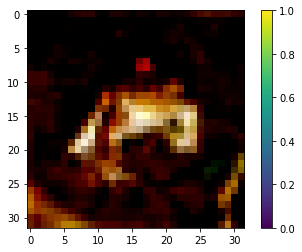

In [41]:
# 첫번째 데이터를 꺼내서 어떻게 생겼는지 확인해보자
plt.imshow(train_x[0].reshape(32, 32, 3))
plt.colorbar()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

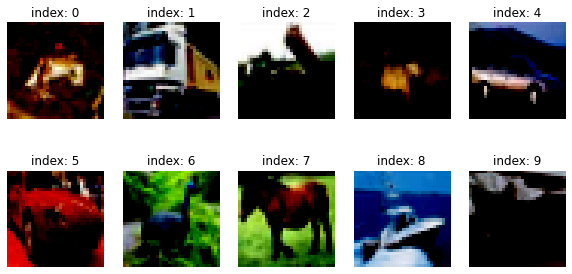

In [42]:
# 열개 보기
plt.figure(figsize=(10, 5))

for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.imshow(train_x[i].reshape(32, 32, 3))
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

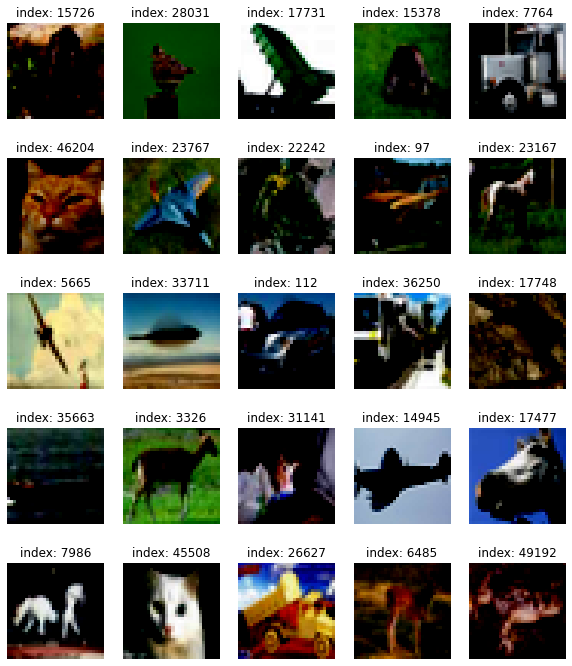

In [43]:
plt.figure(figsize=(10, 12))

for i in range(25):
    plt.subplot(5, 5, i+1)
    random_index = np.random.randint(1, 50000)
    plt.imshow(train_x[random_index].reshape(32, 32, 3))
    plt.title(f'index: {random_index}')
    plt.axis('off')
plt.show()

In [44]:
BUFFER_SIZE = 50000    # 전체 데이터를 섞기 위해 50000으로 설정
BATCH_SIZE = 128    # 모델이 한 번에 학습할 데이터의 양

In [45]:
# tf.data.Dataset 모듈의 from_tensor_slices() 함수를 사용하면
# 리스트, 넘파이, 또는 텐서플로우의 텐서 자료형에서 데이터셋을 만들 수 있다.
# train_x라는 넘파이 배열형 자료를 섞고, 이를 배치 사이즈에 따라 나눈다.
# 단, 데이터가 잘 섞이게 하려면 버퍼 사이즈를 총 데이터 사이즈와 같거나 크게 설정하는 것이 좋다.
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [46]:
# 생성자 모델 구현
# 언제든 생성자를 만들 수 있도록 make_generator_model 함수를 만든다.

def make_generator_model():
    
    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, \
                                     activation='tanh'))

    return model

In [47]:
generator = make_generator_model()

generator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 16384)             1638400   
_________________________________________________________________
batch_normalization_3 (Batch (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 16384)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 8, 8, 128)         819200    
_________________________________________________________________
batch_normalization_4 (Batch (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 8, 8, 128)        

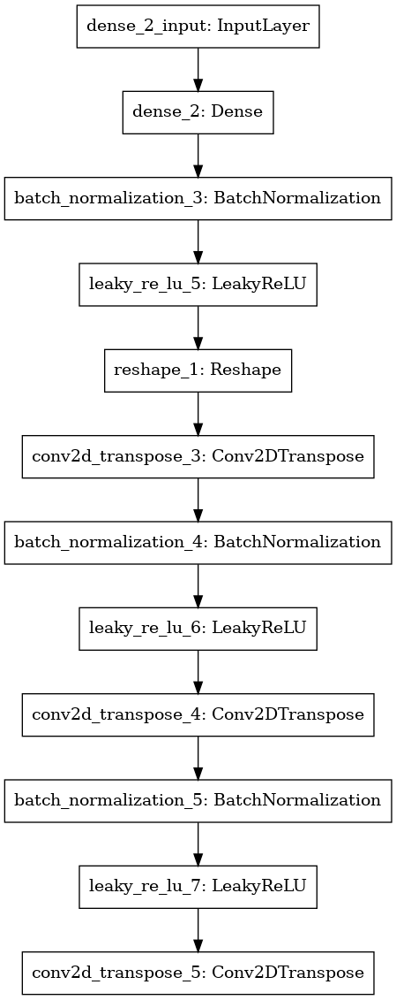

In [48]:
plot_model(generator, to_file='model.png')

In [49]:
noise = tf.random.normal([1, 100])

In [50]:
generated_image = generator(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

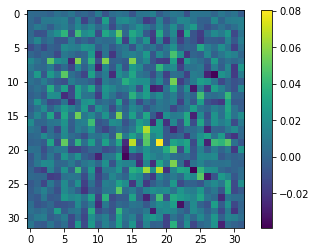

In [51]:
plt.imshow(generated_image[0, :, :, 0])
plt.colorbar()
plt.show()

In [52]:
# 판별자 모델 구현
def make_discriminator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Third: Flatten Layer
    model.add(layers.Flatten())

    # Fourth: Dense Layer
    model.add(layers.Dense(1))

    return model

In [53]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 16, 16, 64)        4864      
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 16, 16, 64)        0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 128)         204928    
_________________________________________________________________
leaky_re_lu_9 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 8, 8, 128)         0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 8192)             

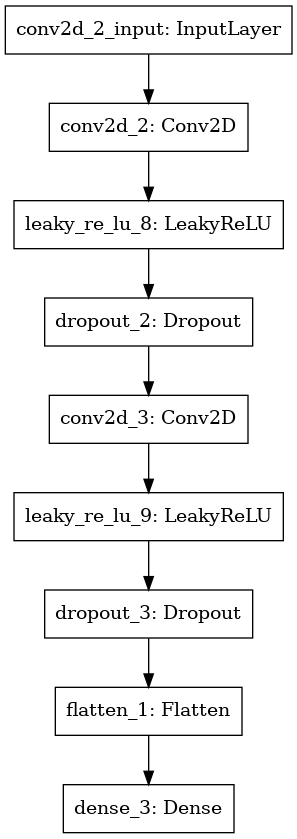

In [54]:
plot_model(discriminator, to_file='model.png')

In [55]:
decision = discriminator(generated_image, training=False)
decision

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[0.00018481]], dtype=float32)>

In [56]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [57]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [58]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.constant(0.9, shape=real_output.shape), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [59]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

In [60]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [61]:
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

In [62]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

In [63]:
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((predictions[i, :, :]+1)/2.0)    # 진환님이 알려주심
        plt.axis('off')
   
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()

In [64]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 10    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [65]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [66]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [67]:
save_every = 5
EPOCHS = 500

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

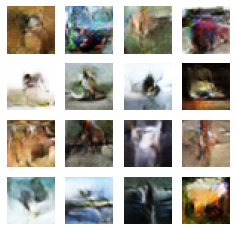

Time for training : 9814 sec


KeyboardInterrupt: 

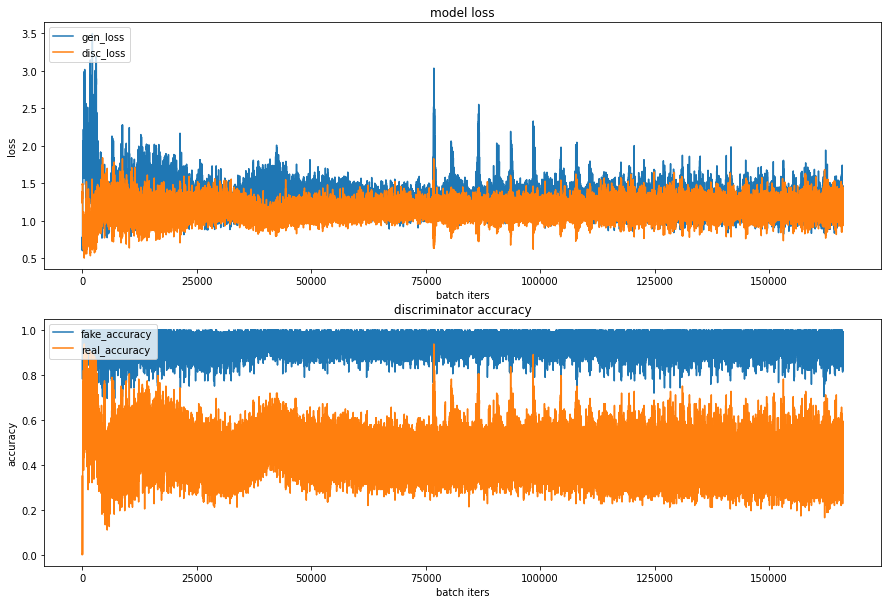

In [68]:
%%time
train(train_dataset, EPOCHS, save_every)

# 학습과정의 loss, accuracy 그래프 이미지 파일이 ~/aiffel/dcgan_newimage/fashion/training_history 경로에 생성되고 있으니
# 진행 과정을 수시로 확인해 보시길 권합니다.

In [69]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_loss.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan.gif

ls: cannot access '/aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan.gif': No such file or directory


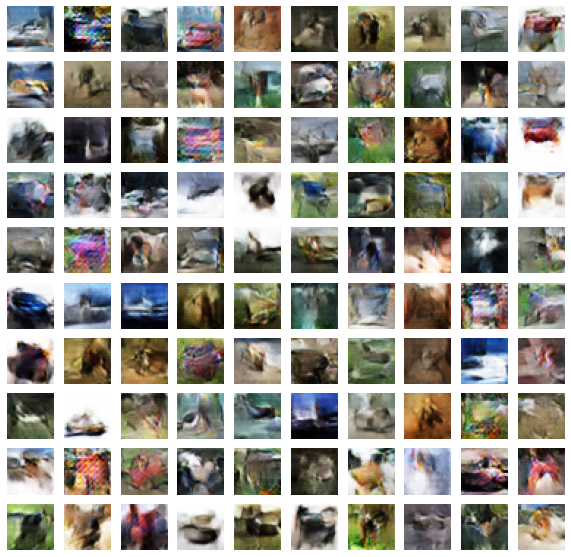

In [70]:
from numpy.random import randn

# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
    # generate points in the latent space
    x_input = randn(latent_dim * n_samples)
    # reshape into a batch of inputs for the network
    x_input = x_input.reshape(n_samples, latent_dim)
    return x_input

# generate images
latent_points = generate_latent_points(100, 100)

predictions = generator(latent_points, training=False)

fig = plt.figure(figsize=(10, 10))
for i in range(predictions.shape[0]):
    plt.subplot(10, 10, i+1)
    #plt.imshow(predictions[i, :, :, 0])
    np_generated = predictions[i].numpy()
    np_generated = (np_generated * 127.5) + 127.5 # reverse of normalization
    np_generated = np_generated.astype(int)
    plt.imshow(np_generated)
    plt.axis('off')
plt.show()

### 훈련 과정 개선하기

실습 코드 그대로인 모델로 수행한 결과

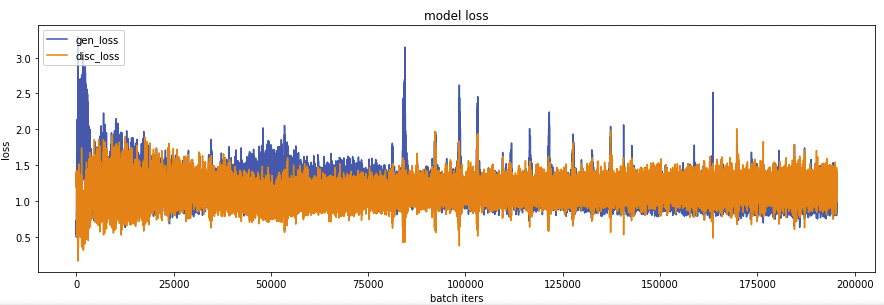

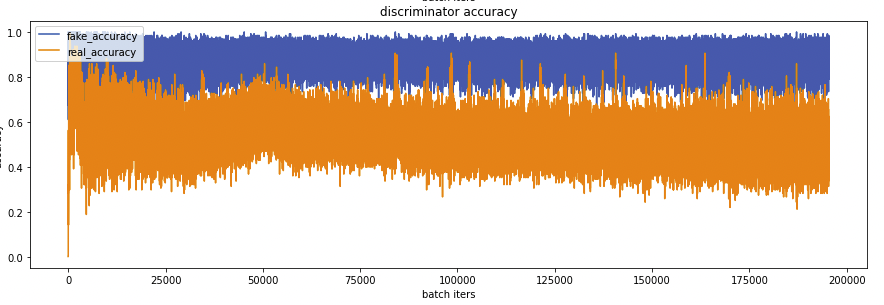

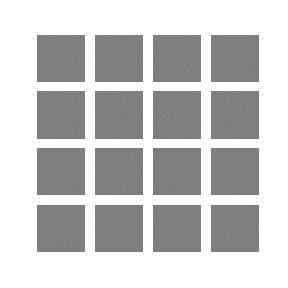

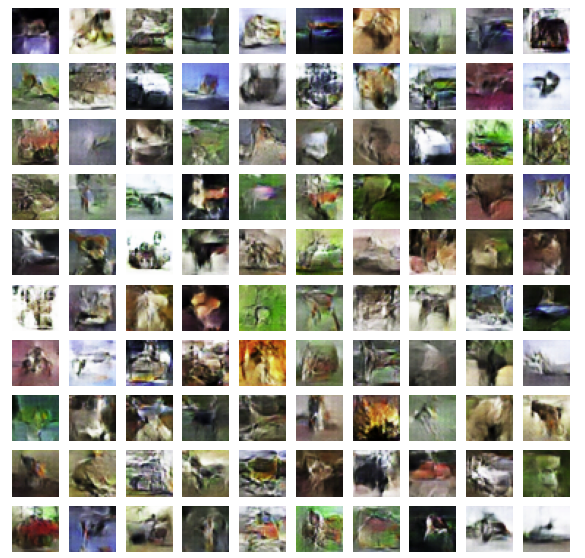

* 샘플 이미지가 명확하게 구분하기 어렵다. 개선할 수 있는 방법으로 생각되는 건,
    * 학습을 epoch 500이 아니라 그 이상으로 하는 것: 다른 분들과 의견을 나눈 결과 500이상에서 같은 모델로 아무리 학습을 많이 해도 크게 나아지지 않는 것 같다.
    

#### 방법 1: stride값을 전부 (2, 2)로 맞추기
* stride값을 변경하면서 이미지 사이즈도 변해서 맞추기 위해 layer구성을 변경했다. 그러다보니 (2, 2)말고 다른 값으로 맞추기가 어려웠다.

* generator 모델

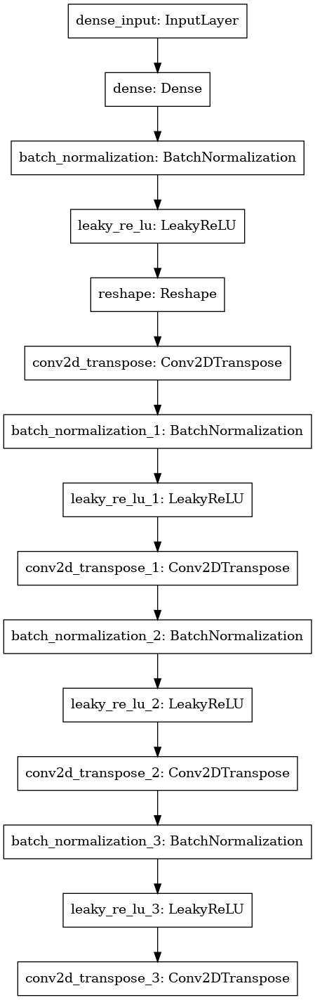

* discriminator

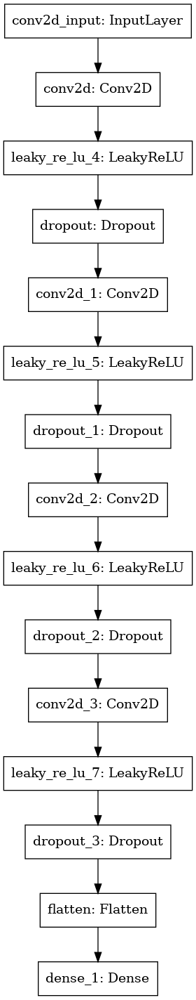

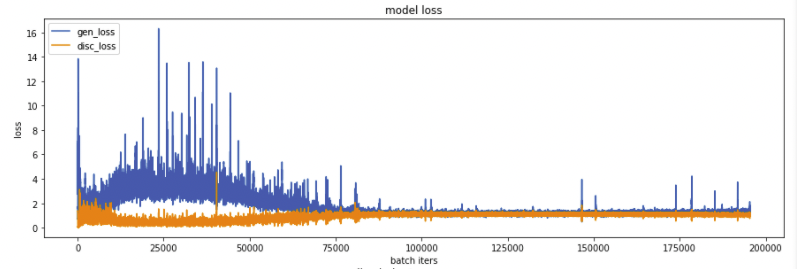

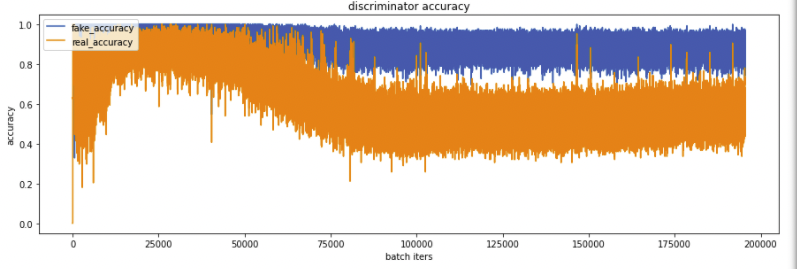

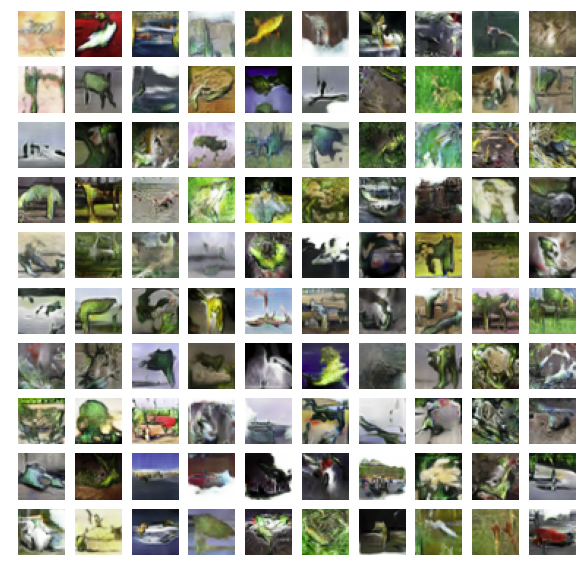

기본 모델보다 이미지 자체는 조금 더 명확해보인다. 하지만 무슨 이미지인지는 모르겠다. 다만 성능 상승의 원인이 모델 구조 변경 자체인지 stride값 변경인지 알 수가 없다.

#### 방법2: learning ratefmf 2e-4로 설정
https://github.com/hyyoo3526/AIFFEL_EXPLORATION/blob/main/EXPLORATION_13/EXPLORATION_IC1_13_dcgan_newimage.ipynb
에서 참고하였습니다.

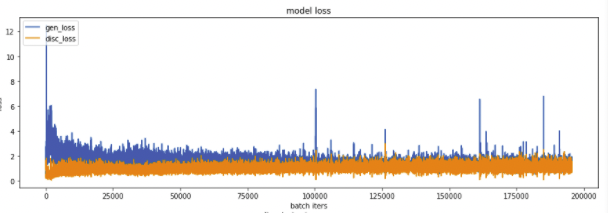

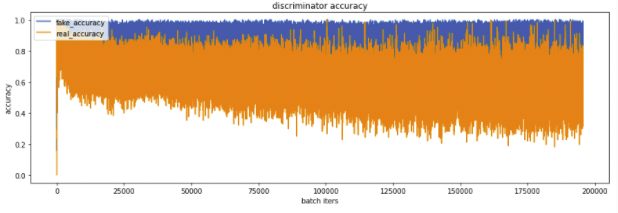

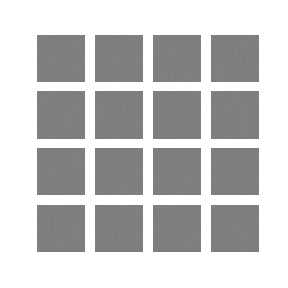

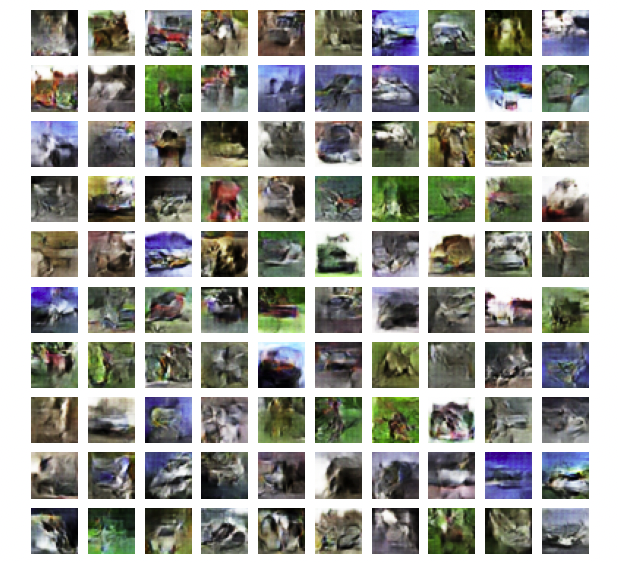

전체적으로 훨씬 떨어지는 성능을 보였다. 그래프는 크게 진동하거나 loss가 아주 조금이지만 증가하는 경향을 보이고, 무엇보다 이미지가 흐릿하다.

#### 방법3: One-sided label smoothing 적용해보기
https://github.com/adele2020/ssacxaiffel/blob/main/%5BE12%5D_CIFAR-10_generation.ipynb
에서 참고하였고, 실제 데이터에 대한 target값을 1보다 약간 작은 값으로 해준다(0.9).

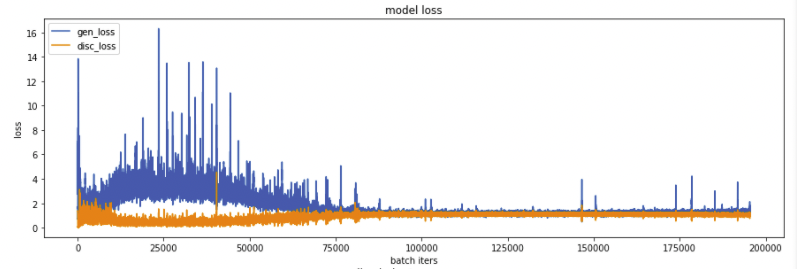

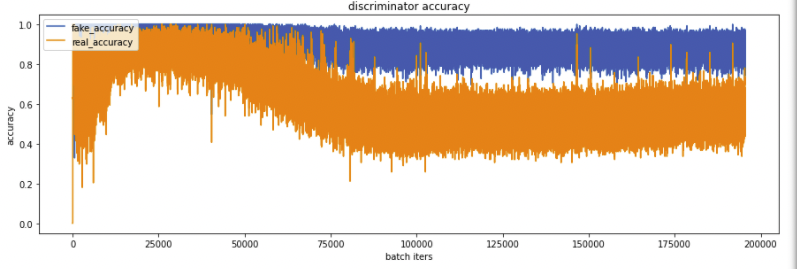

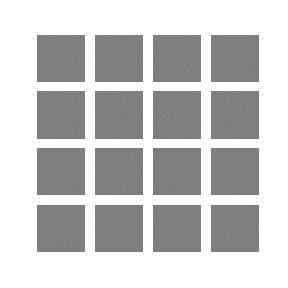

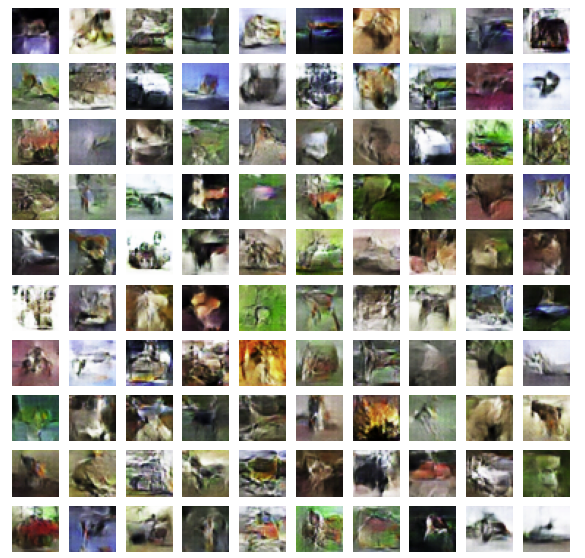

이 방법이 마지막이었는데 시간이 부족해서 epoch 500 중 425만 수행 후 중지. 이미지가 흐릿한 것의 원인은 부족한 epoch는 아닌 것 같다.

### 회고

* -1, 1 사이 값으로 정규화해줬던 것을 풀지 않으면 이미지 생성이 제대로 진행되지 않는다는 것을 알았다.

* 하이퍼파라미터나 learning rate, loss 등의 값을 바꾸는 것이 눈에 띄는 성능 향상으로 이어지지는 않는 것 같다. 다양한 조합을 시도하면 더 나은 성능을 낼 수 있을 것 같긴한데 기본 모델에서 하나씩 적용하다보니 확연한 성능 차이는 보이지 않은 것 같고, 오히려 이미지가 더 흐릿하게 보이는 것 같기도 하다. 마지막으로 GAN의 성능 향상을 위한 방법에 어떤 것이 있고, 어떻게 적용하는지에 대해 천천히 알아봐야할 것 같다.

* 결과적으로 성능 향상을 위해 시도한 세가지 방법 중 가장 나은 성능을 보인 것은 stride를 2,2로 맞춘 방법이었다.